# Missing data imputation


In [ ]:
pip install miceforest

## Importation et load du dataset

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [ ]:
df = pd.read_csv('/water_potability.csv')


## Data processing

In [ ]:
df.head()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,NaN,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,NaN,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,NaN,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


In [ ]:
df.shape

(3276, 10)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               2785 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          2495 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3114 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB


In [ ]:
df.isnull().sum()

,0
ph,491
Hardness,0
Solids,0
Chloramines,0
Sulfate,781
Conductivity,0
Organic_carbon,0
Trihalomethanes,162
Turbidity,0
Potability,0


On remarque que ya des valeur manquantes pour le ph, sulfate, Trihalomethanes

In [ ]:
df.describe().T


,count,mean,std,min,25%,50%,75%,max
ph,2785.0,7.080795,1.594320,0.000000,6.093092,7.036752,8.062066,14.000000
Hardness,3276.0,196.369496,32.879761,47.432000,176.850538,196.967627,216.667456,323.124000
Solids,3276.0,22014.092526,8768.570828,320.942611,15666.690297,20927.833607,27332.762127,61227.196008
Chloramines,3276.0,7.122277,1.583085,0.352000,6.127421,7.130299,8.114887,13.127000
Sulfate,2495.0,333.775777,41.416840,129.000000,307.699498,333.073546,359.950170,481.030642
Conductivity,3276.0,426.205111,80.824064,181.483754,365.734414,421.884968,481.792304,753.342620
Organic_carbon,3276.0,14.284970,3.308162,2.200000,12.065801,14.218338,16.557652,28.300000
Trihalomethanes,3114.0,66.396293,16.175008,0.738000,55.844536,66.622485,77.337473,124.000000
Turbidity,3276.0,3.966786,0.780382,1.450000,3.439711,3.955028,4.500320,6.739000
Potability,3276.0,0.390110,0.487849,0.000000,0.000000,0.000000,1.000000,1.000000


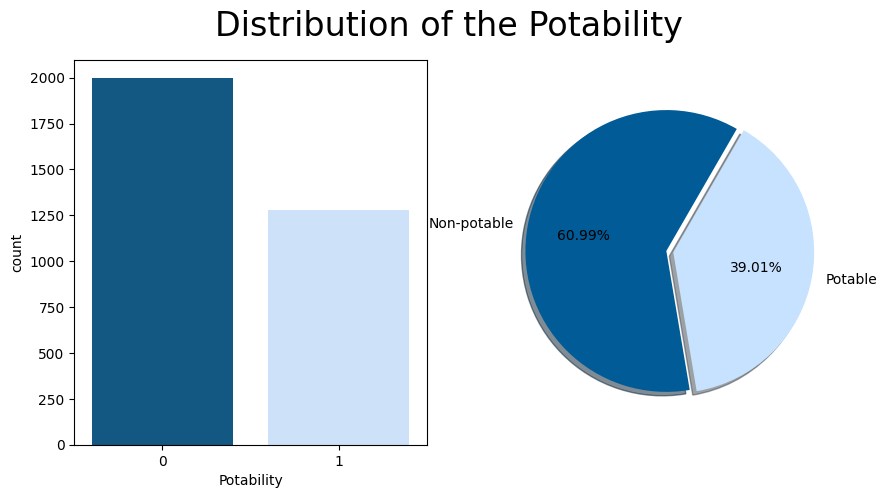

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(10,5))

# Count
sns.countplot(x="Potability", data=df,ax=ax[0], palette=['#005b96',"#c6e2ff"])

# Pie
ax[1] = plt.pie(df["Potability"].value_counts(),
            labels=['Non-potable', 'Potable'],
            autopct='%1.2f%%',
            shadow=True,
            explode=(0.05, 0),
            startangle=60,
            colors=['#005b96',"#c6e2ff"]
                )

fig.suptitle('Distribution of the Potability', fontsize=24)

plt.show()

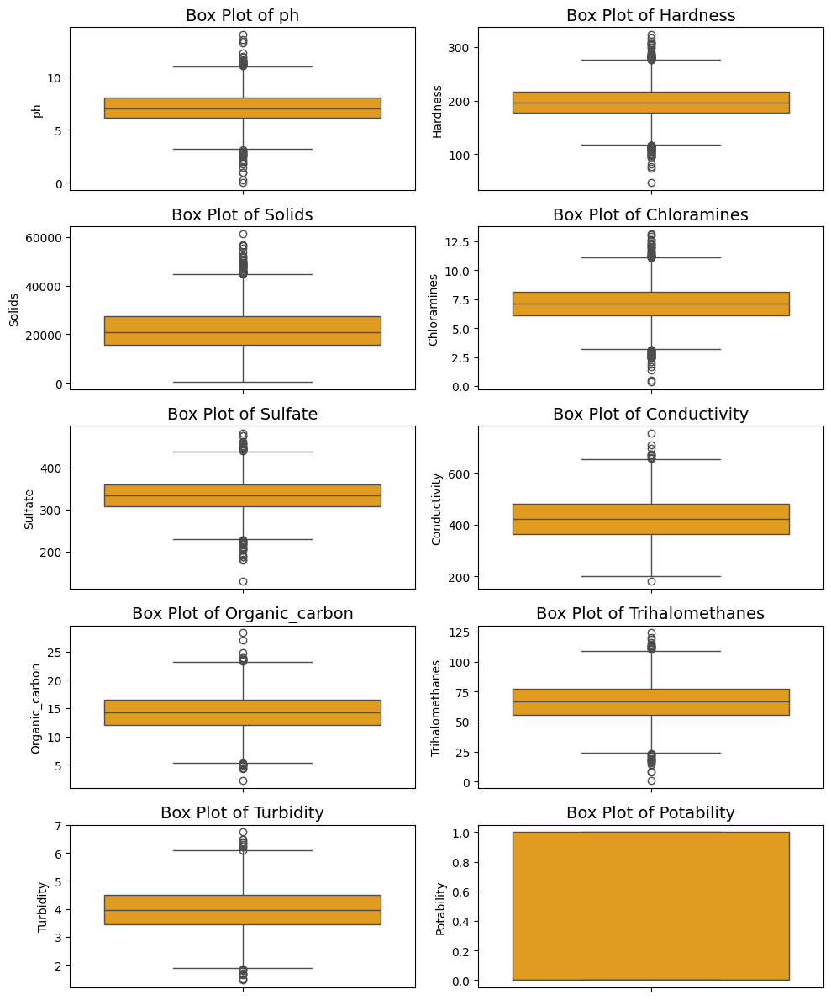

In [ ]:
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(10, 12))
axes = axes.flatten()

for i, col in enumerate(df):
    sns.boxplot(y=col, data=df, ax=axes[i],color="orange")
    axes[i].set_title(f'Box Plot of {col}', fontsize=14)
    axes[i].set_ylabel(col)

plt.tight_layout()
plt.show()

L'ensemble de données contient des valeurs aberrantes, que je vais donc supprimer.


**Traitement des valeurs aberrantes**

In [ ]:
def handling_outlier(data,variable):
    quartile1 = data[variable].quantile(0.2) # Range (%20-%80)
    quartile3 = data[variable].quantile(0.8)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    data.loc[data[variable] < low_limit, variable] = low_limit
    data.loc[data[variable] > up_limit, variable] = up_limit

In [ ]:
for col in df.columns[:-1]:
    handling_outlier(df, col)



**Recontrôle des valeurs aberrantes.**

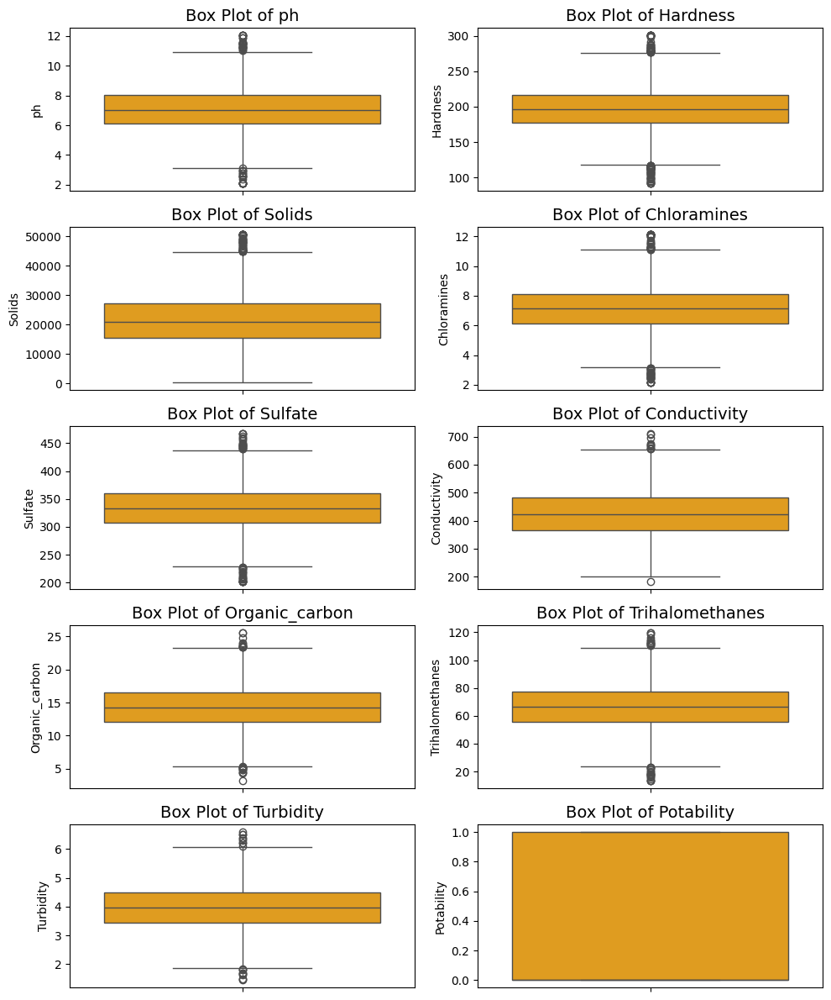

In [ ]:
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(10, 12))
axes = axes.flatten()

for i, col in enumerate(df):
    sns.boxplot(y=col, data=df, ax=axes[i],color="orange")
    axes[i].set_title(f'Box Plot of {col}', fontsize=14)
    axes[i].set_ylabel(col)

plt.tight_layout()
plt.show()

**Vérification des valeurs manquantes.**

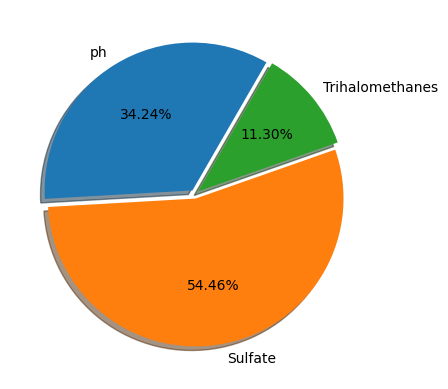

In [ ]:
df.isnull().sum()

plt.pie(df[['ph', 'Sulfate', 'Trihalomethanes']].isnull().sum(),
            labels=df.columns[df.isnull().any()],
            autopct='%1.2f%%',
            shadow=True,
            explode=(0.03, 0.03, 0.03),
            startangle=60)

plt.show()

Traitement des valeurs manquantes

Nous allons essayer plusieurs méthodes pour imputer les valeurs manquantes ;

    Imputation moyenne

    Imputation par les plus proches voisins (K-Nearest Neighbors)

    Imputation multiple (MiceForest)

    Imputation par modélisation prédictive (RandomForestRegressor)

Tout d'abord, nous copierons la base de données originale afin de la comparer avec les autres.

In [ ]:
df_mean = df.copy()
df_knn = df.copy()
df_mice = df.copy()
df_rf = df.copy()

1. **Imputation de la moyenne**

In [ ]:
for col in df.columns[df.isnull().any()]:
    df_mean[col].fillna(df_mean[col].mean(), inplace=True)


2. **Imputation par les plus proches voisins (K-Nearest Neighbors)**

In [ ]:
from sklearn.impute import KNNImputer

knn_imp = KNNImputer(n_neighbors=4)
df_knn = pd.DataFrame(knn_imp.fit_transform(df_knn), columns=df_knn.columns)

3. **Imputation multiple (MiceForest)**

In [ ]:
from miceforest import ImputationKernel

mice_kernel = ImputationKernel(data=df_mice, random_state=41)
mice_kernel.mice(2)
df_mice = mice_kernel.complete_data()

4. **Imputation par modélisation prédictive (RandomForestRegressor)**

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()

def fill_missing_numerical(df, col):

    known = df[df[col].notnull()]
    unknown = df[df[col].isnull()]
    X = known.drop(df.columns[df.isnull().any()], axis=1) # features
    y = known[col] # target
    rf.fit(X, y)
    unknown[col] = rf.predict(unknown.drop(df.columns[df.isnull().any()], axis=1))
    df[col].fillna(unknown[col], inplace=True)

In [ ]:
for col in df_rf.columns[df_rf.isnull().any()]:
    fill_missing_numerical(df_rf, col)



**Recontrôle**

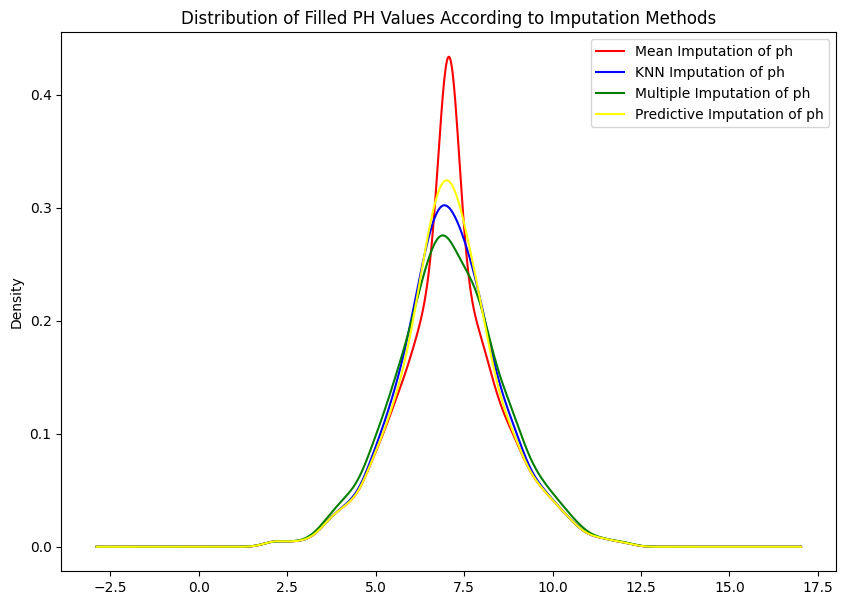

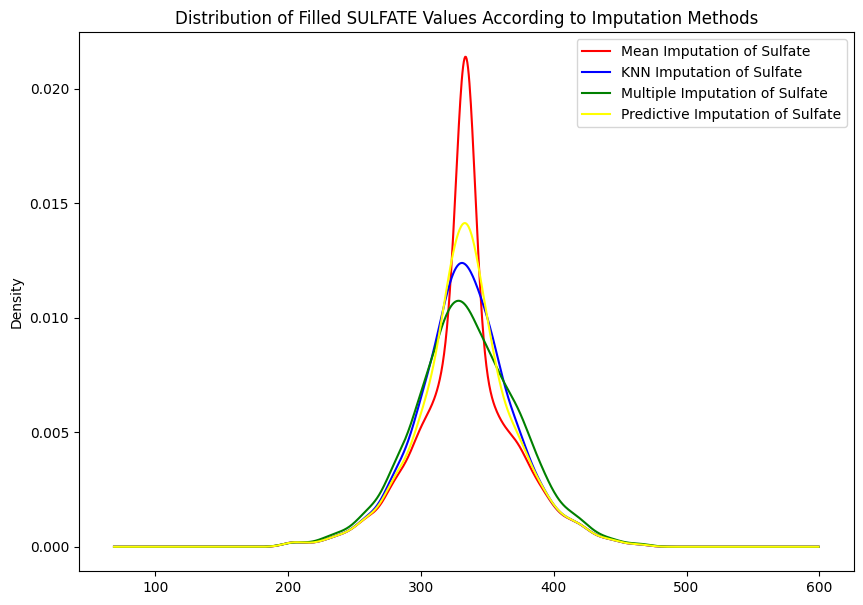

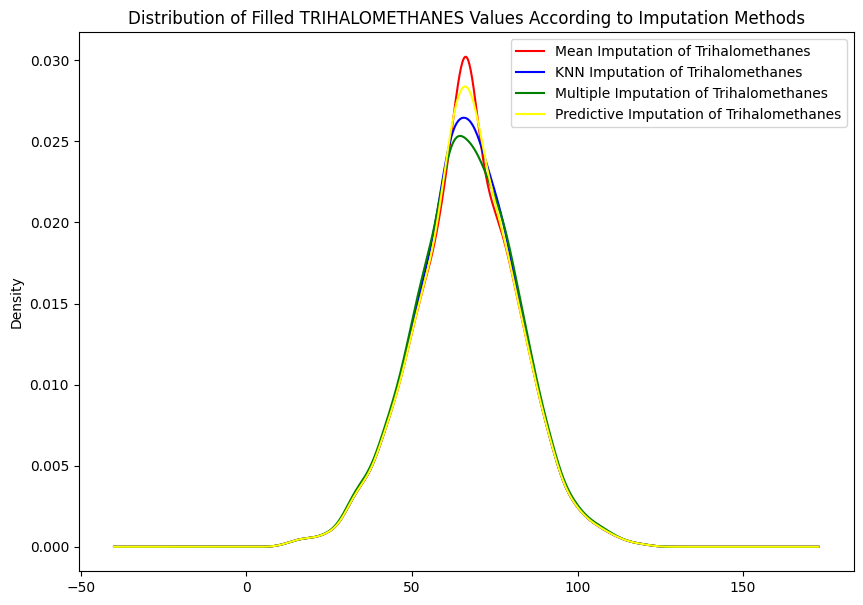

In [ ]:
for col in df.columns[df.isnull().any()]:
    plt.figure(figsize=(10,7))
    df_mean.rename(columns={col: 'Mean Imputation of ' + col})['Mean Imputation of ' + col].plot(kind='kde',color='red')
    df_knn.rename(columns={col: 'KNN Imputation of ' + col})['KNN Imputation of ' + col].plot(kind='kde',color='blue')
    df_mice.rename(columns={col: 'Multiple Imputation of ' + col})['Multiple Imputation of ' + col].plot(kind='kde',color='green')
    df_rf.rename(columns={col: 'Predictive Imputation of ' + col})['Predictive Imputation of ' + col].plot(kind='kde',color='yellow')


    plt.legend()
    plt.title("Distribution of Filled " + col.upper() + " Values According to Imputation Methods")

**Distribution des valeurs remplies selon les méthodes d'imputation.**


2.1 Analyse et visualisation des données¶

Diagrammes de paires de valeurs remplies selon les méthodes d'imputation.

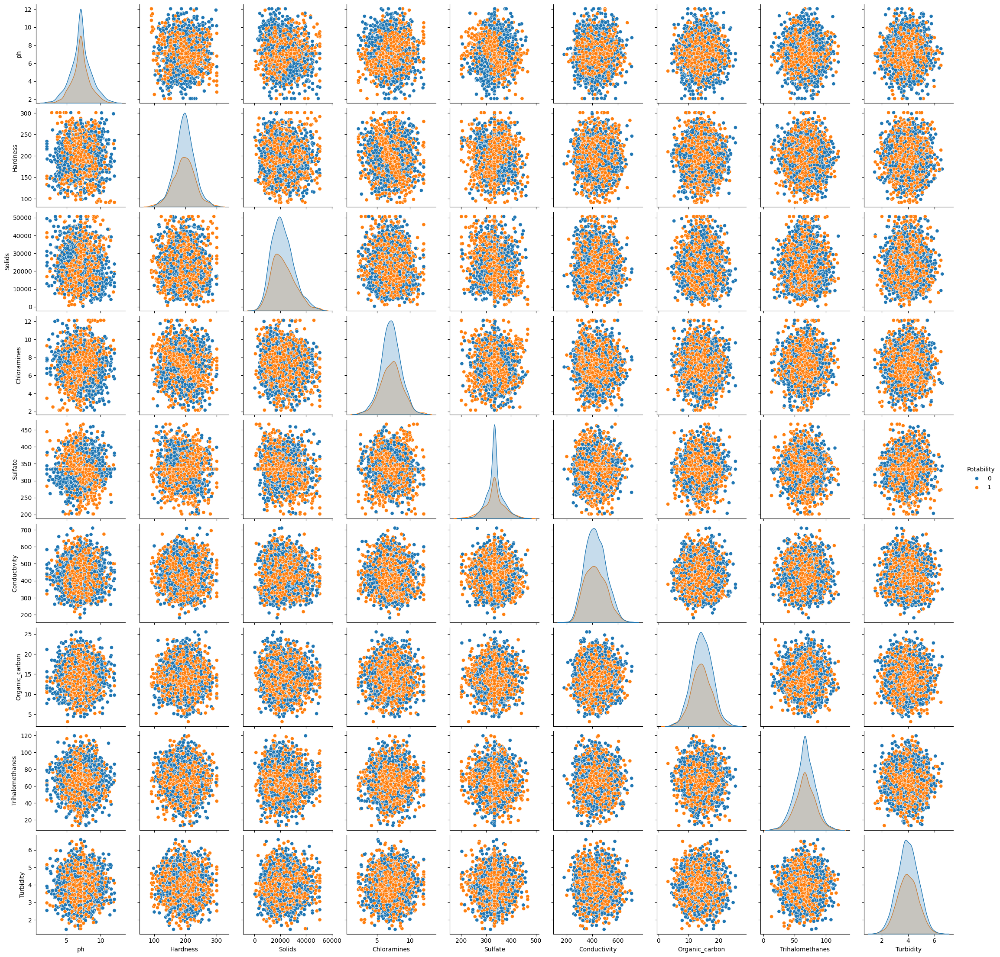

In [ ]:
# Mean Imputation
sns.pairplot(df_mean, hue='Potability')
plt.show()

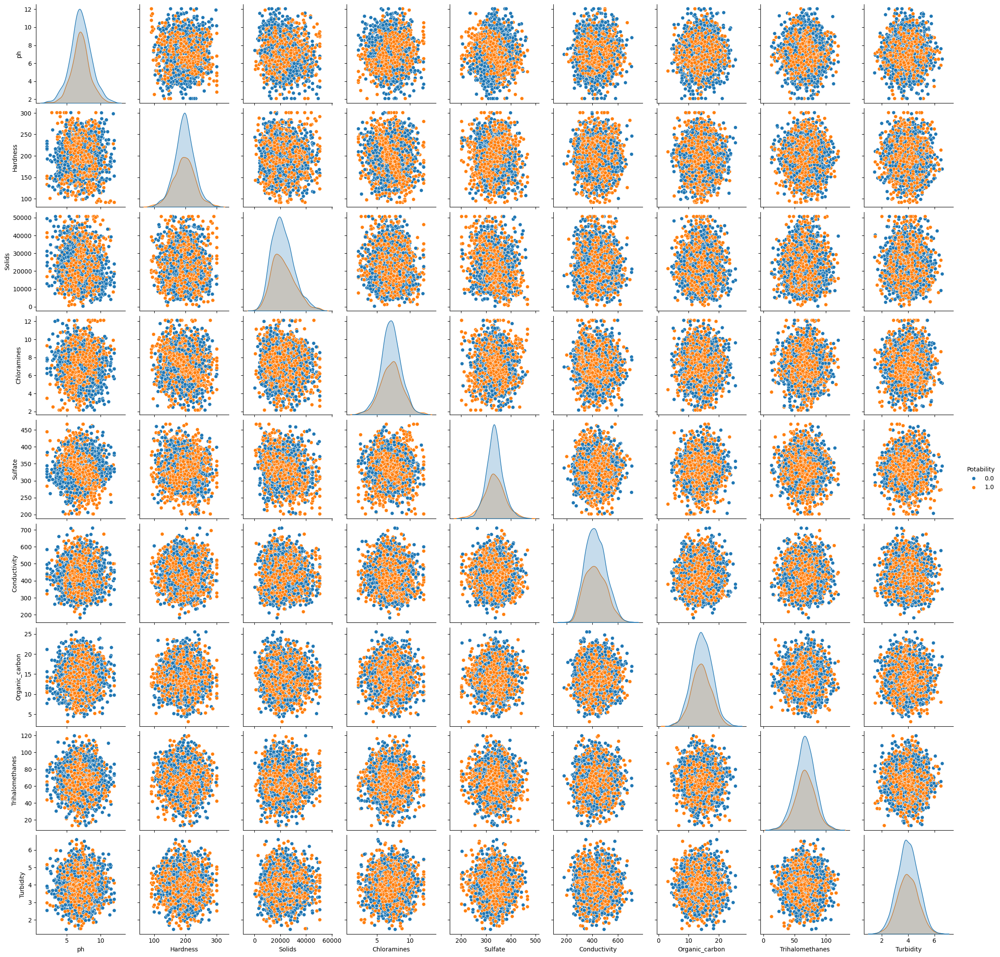

In [ ]:
# KNN Imputation
sns.pairplot(df_knn, hue='Potability')
plt.show()

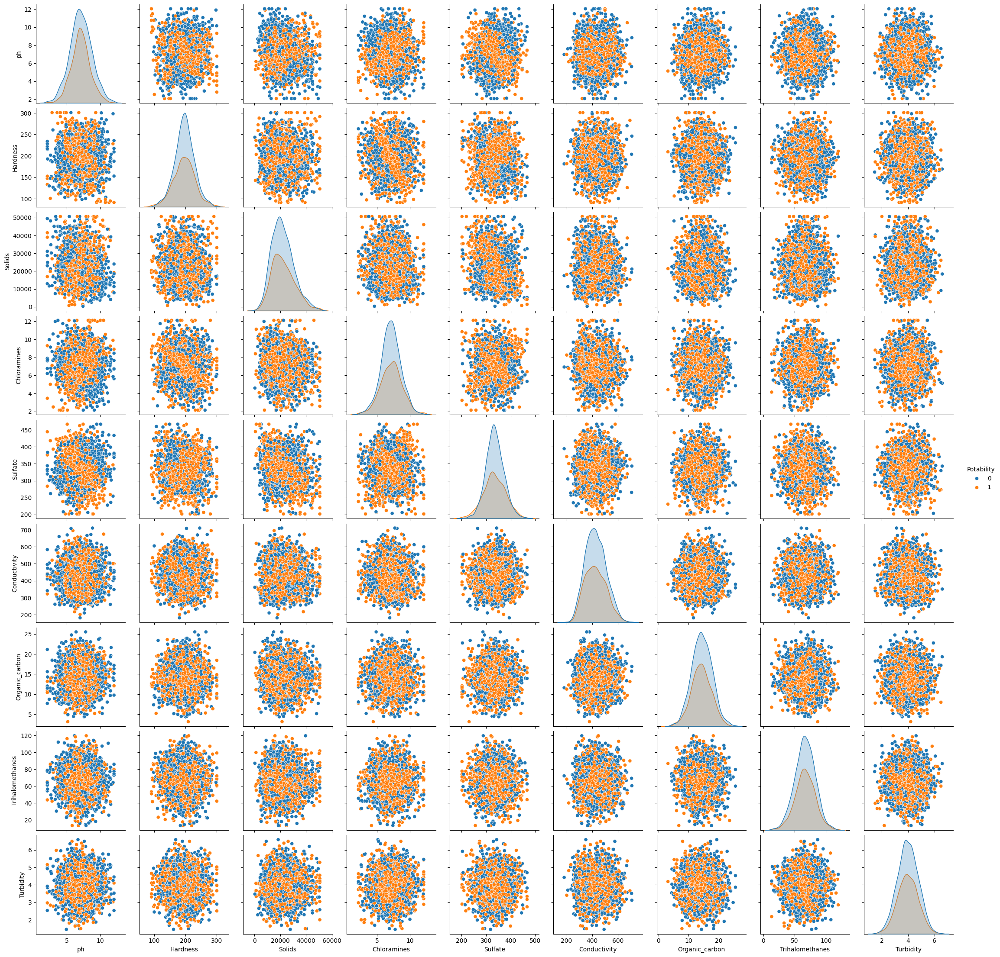

In [ ]:
# Multiple Imputation
sns.pairplot(df_mice, hue='Potability')
plt.show()

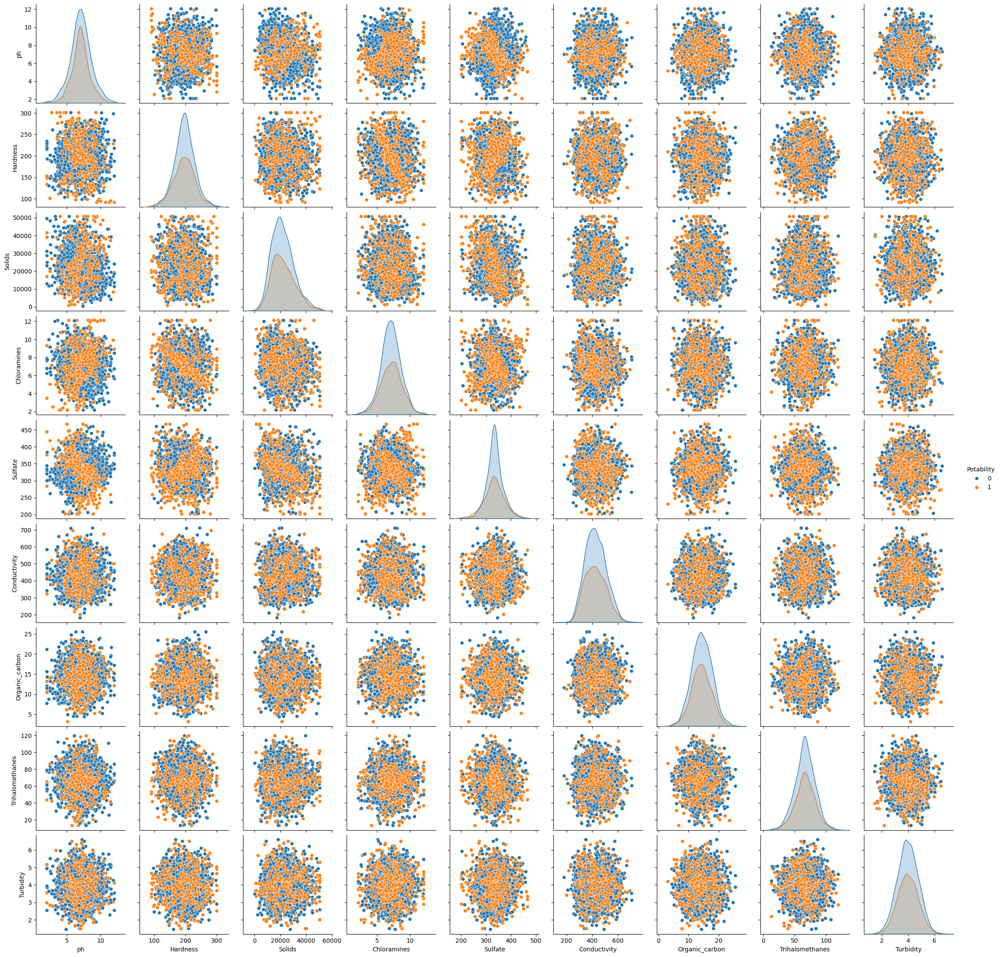

In [ ]:
# Predictive Imputation
sns.pairplot(df_rf, hue='Potability')
plt.show()



**Matrices de corrélation des valeurs remplies selon les méthodes d'imputation**

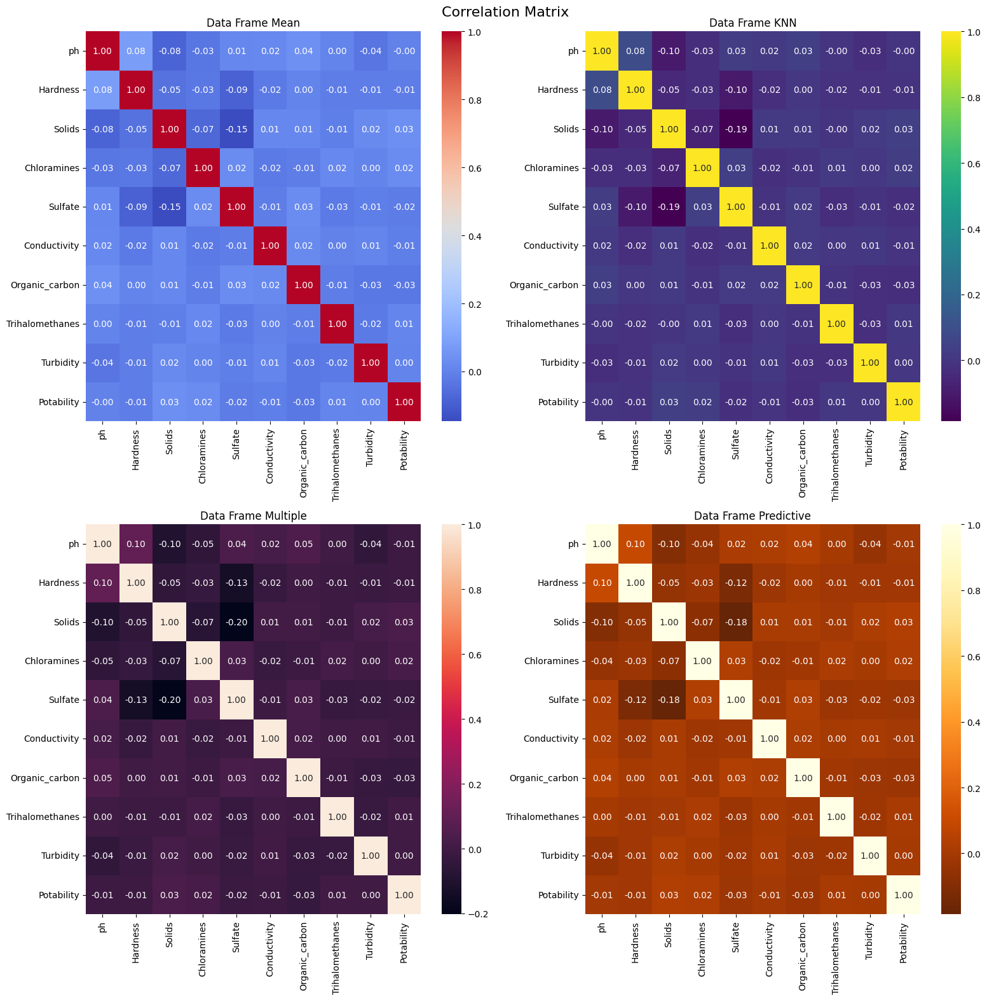

In [ ]:
fig, ax = plt.subplots(2,2, figsize=(16,16))

sns.heatmap(df_mean.corr(),annot=True, cmap='coolwarm', fmt=".2f", ax=ax[0,0]).set_title('Data Frame Mean')
sns.heatmap(df_knn.corr(),annot=True, cmap='viridis', fmt=".2f", ax=ax[0,1]).set_title('Data Frame KNN')
sns.heatmap(df_mice.corr(),annot=True, cmap='rocket', fmt=".2f", ax=ax[1,0]).set_title('Data Frame Multiple')
sns.heatmap(df_rf.corr(),annot=True, cmap='YlOrBr_r', fmt=".2f", ax=ax[1,1]).set_title('Data Frame Predictive')

fig.suptitle('Correlation Matrix', fontsize=16)
plt.tight_layout()
plt.show()

Nous pouvons constater qu'il existe des différences entre eux, même si elles sont minimes.
3. Modèle d'apprentissage automatique

Préparation des données pour la modélisation

Nous préparons des ensembles d'entraînement et de test pour chaque méthode.

In [ ]:
from sklearn.model_selection import train_test_split
# Mean Imputation
X_mean = df_mean.drop("Potability",axis=1)
y_mean = df_mean[["Potability"]]

# KNN Imputation
X_knn = df_knn.drop("Potability",axis=1)
y_knn = df_knn[["Potability"]]

# Multiple Imputation
X_mice = df_mice.drop("Potability",axis=1)
y_mice = df_mice[["Potability"]]

# Predictive Imputation
X_rf = df_rf.drop("Potability",axis=1)
y_rf = df_rf[["Potability"]]

In [ ]:
X_mean_train, X_mean_test, y_mean_train, y_mean_test = train_test_split(X_mean, y_mean, test_size = 0.2, random_state = 0)

X_knn_train, X_knn_test, y_knn_train, y_knn_test = train_test_split(X_knn, y_knn, test_size = 0.2, random_state = 0)

X_mice_train, X_mice_test, y_mice_train, y_mice_test = train_test_split(X_mice, y_mice, test_size = 0.2, random_state = 0)

X_rf_train, X_rf_test, y_rf_train, y_rf_test = train_test_split(X_rf, y_rf, test_size = 0.2, random_state = 0)

**Fonction de calcul.**

In [ ]:
def calculate(y):
    acc = accuracy_score(y,y_test)
    pre = precision_score(y,y_test)
    rec = recall_score(y,y_test)
    f1 = f1_score(y,y_test)
    return acc,pre,rec,f1

In [ ]:
data = [("Mean", X_mean_train,X_mean_test,y_mean_train,y_mean_test),
        ("KNN", X_knn_train,X_knn_test,y_knn_train,y_knn_test),
        ("Multiple", X_mice_train,X_mice_test,y_mice_train,y_mice_test),
        ("Predictive", X_rf_train,X_rf_test,y_rf_train,y_rf_test)]

**3.1 Modélisation**

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn.metrics import  accuracy_score, precision_score, recall_score, f1_score,roc_auc_score,roc_curve

**Nous utiliserons les modèles suivants : Gradient Boosting Classifier, Random Forest Classifier, XGBoost Classifier et LightGBM Classifier.**

In [ ]:
gbc = GradientBoostingClassifier()
rfc = RandomForestClassifier()
xgbc = XGBClassifier()
lgbc = lgb.LGBMClassifier(verbose=-1)

models = [("Gradient Boosting",gbc), ("Random Forest", rfc), ("XBoost", xgbc), ("LightGBM", lgbc)]



**Fonction ROC-CURVE**

In [ ]:
def plot_roc(j, set, name, y_pred, y_test):

    plt.subplot(2, 2, j)
    ns_probs = [0 for i in range(len(y_test))]
    ns_auc = roc_auc_score(y_test, ns_probs)
    ns_fpr, ns_tpr, _ = roc_curve(y_test, ns_probs)

    classifier_fpr, classifier_tpr, _ = roc_curve(y_test, y_pred)
    auc = roc_auc_score(y_pred, y_test)

    plt.plot(ns_fpr, ns_tpr, linestyle='solid')
    plt.plot(classifier_fpr, classifier_tpr,linestyle="dashed", marker='.', label = name + " (AUC = %0.4f)" % auc)

    plt.title('ROC Plot for ' + set + ' Imputation Data Set' )
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend(loc='best')
    plt.tight_layout()

**Fonction de modélisation.**

In [ ]:
cls_rep = []
def model_call(j, set, X_train, X_test, y_train, y_test):


    for name, model in models:
        model.fit(X_train,y_train)
        y_pred = model.predict(X_test)
        acc, pre, rec, f1 = calculate(y_pred)
        cls_rep.append({'Data': set,'Model': name,'Accuracy': acc,'Precision': pre,'Recall': rec,'F1 Score': f1})

        plot_roc(j, set, name, y_pred, y_test)

    return cls_rep



4. Visualisation et évaluation des résultats

Visualisation de la courbe ROC-AUC

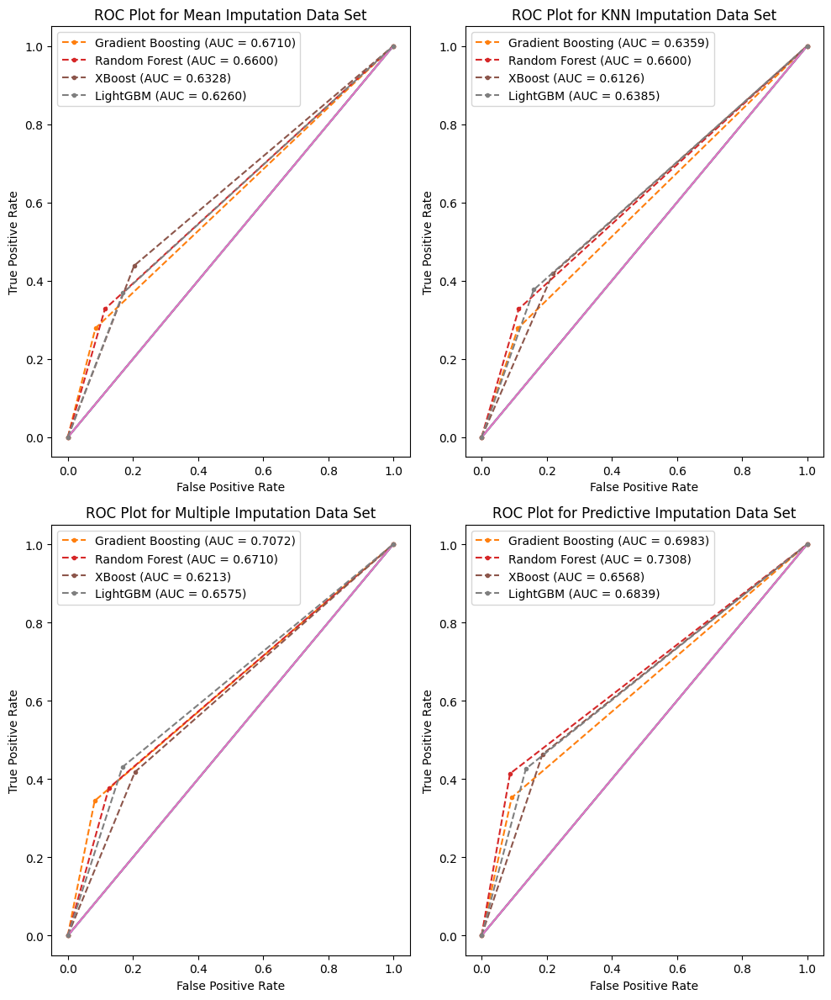

In [ ]:
j = 0
plt.figure(figsize=(10,12))
for set, X_train, X_test, y_train, y_test in data:
    j += 1
    cls_rep = model_call(j, set, X_train, X_test, y_train, y_test)

**Nous pouvons clairement voir la courbe roc-auc de chaque modèle dans chaque ensemble de données.**

**Visualisation des mesures de la matrice de confusion**

In [ ]:
def plot_metrics(k,data_name, df):

    ax = fig.add_subplot(2,2,k)
    df.plot(kind="bar",ax=ax)
    ax.set_title("Evaluation Metrics of Data Frame " + data_name.upper(), fontweight='bold')
    ax.set_xlabel("Metrics", fontweight='bold')
    ax.set_ylabel("Score", fontweight='bold')
    ax.set_xticklabels(rotation=0,labels=df.index)
    ax.grid(color='gray', linestyle=':', linewidth=0.6, zorder=0)
    ax.set_axisbelow(True)
    ax.legend(frameon=False,fontsize="9")
    fig.tight_layout()

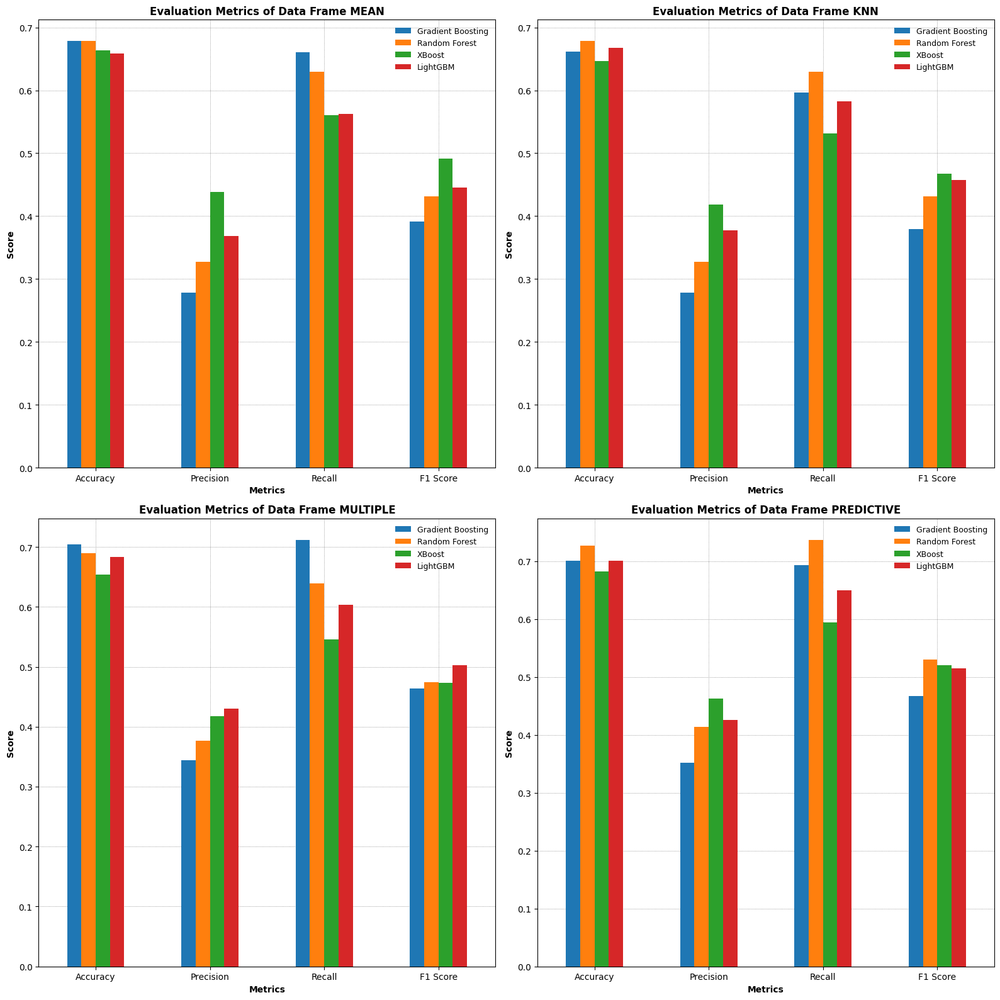

In [ ]:
fig = plt.figure(figsize=(16,16))
k = 0
for i in range(0,16,4):
    df = pd.DataFrame(data = cls_rep[i:i+4])
    data_name = cls_rep[i]["Data"]
    df.drop("Data",axis=1,inplace=True)
    df = df.set_index("Model").unstack(level=1).unstack()
    k += 1
    plot_metrics(k,data_name, df)

**Conclusion** : En examinant le graphique, nous pouvons dire que l'imputation prédictive est meilleure que les autres pour cet ensemble de données.